# Optimizing marketing expenses for Yandex.Afisha

# Project description
Yandex.Afisha is an online platform for purchasing concerts and movie tickets. Our task was to help Yandex.Afisha optimize marketing expenses.

Our data contained:

- Server logs with data on Yandex.Afisha visits from June 2017 through May 2018
- Dump file with all orders for the period
- Marketing expenses statistics

We studied the following:

- How people use the product
- When they start to buy
- How much money each customer brings
- When they pay off

# Description of the data
The visits table (server logs with data on website visits):

- Uid — user's unique identifier
- Device — user's device
- Start Ts — session start date and time
- End Ts — session end date and time
- Source Id — identifier of the ad source the user came from

All dates in this table are in YYYY-MM-DD format.
The orders table (data on orders):

- Uid — unique identifier of the user making an order
- Buy Ts — order date and time
- Revenue — Yandex.Afisha's revenue from the order

The costs table (data on marketing expenses):

- source_id — ad source identifier
- dt — date
- costs — expenses on this ad source on this day


# Imports

In [18]:
# !pip install pandas -U
# !pip install plotly -U
# !pip install sidetable

In [19]:
from IPython.display import display

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns
import sidetable as stb


# Load the data and prepare it for analysis

## Load a small fraction of the data for initial inspection

In [20]:
visits = pd.read_csv('./datasets/visits_log_us.csv', nrows=50)
orders = pd.read_csv('./datasets/orders_log_us.csv', nrows=50)
costs = pd.read_csv('./datasets/costs_us.csv', nrows=50)


In [21]:
data_sets = [
    visits,
    orders,
    costs
]
data_set_names = [
    'visits',
    'orders',
    'costs'
]

### Look the data sets

In [22]:
i=0
for name, data_set in zip(data_set_names, data_sets):
    print()
    print(name)
    print('-'*len(name))
    display(data_set.head())
    print()
    if i != len(data_sets) - 1:
        print('='*50)
    i += 1
    



visits
------


,Device,End Ts,Source Id,Start Ts,Uid
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9969694820036681168




orders
------


,Buy Ts,Revenue,Uid
0,2017-06-01 00:10:00,17.00,10329302124590727494
1,2017-06-01 00:25:00,0.55,11627257723692907447
2,2017-06-01 00:27:00,0.37,17903680561304213844
3,2017-06-01 00:29:00,0.55,16109239769442553005
4,2017-06-01 07:58:00,0.37,14200605875248379450




costs
-----


,source_id,dt,costs
0,1,2017-06-01,75.20
1,1,2017-06-02,62.25
2,1,2017-06-03,36.53
3,1,2017-06-04,55.00
4,1,2017-06-05,57.08


### Look at the distributions of the data sets

In [23]:
i=0
for name, data_set in zip(data_set_names, data_sets):
    print()
    print(name)
    print('-'*len(name))
    display(data_set.describe())
    print()
    if i != len(data_sets) - 1:
        print('='*50)
    i += 1
    



visits
------


,Source Id,Uid
count,50.000000,5.000000e+01
mean,4.220000,1.059456e+19
std,1.961778,5.463877e+18
min,1.000000,6.313764e+16
25%,3.000000,7.426687e+18
50%,4.000000,1.099969e+19
75%,5.000000,1.554812e+19
max,10.000000,1.818836e+19




orders
------


,Revenue,Uid
count,50.000000,5.000000e+01
mean,5.122000,9.849153e+18
std,15.516944,5.360116e+18
min,0.180000,1.074355e+18
25%,0.550000,5.626278e+18
50%,1.830000,1.007192e+19
75%,4.150000,1.383080e+19
max,110.000000,1.834601e+19




costs
-----


,source_id,costs
count,50.0,50.000000
mean,1.0,38.235800
std,0.0,16.214995
min,1.0,5.800000
25%,1.0,25.897500
50%,1.0,36.755000
75%,1.0,47.610000
max,1.0,90.870000


### General info

In [24]:
i=0
for name, data_set in zip(data_set_names, data_sets):
    print()
    print(name)
    print('-'*len(name))
    display(data_set.info(memory_usage='deep'))
    print()
    if i != len(data_sets) - 1:
        print('='*50)
    i += 1


visits
------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50 entries, 0 to 49
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Device     50 non-null     object
 1   End Ts     50 non-null     object
 2   Source Id  50 non-null     int64 
 3   Start Ts   50 non-null     object
 4   Uid        50 non-null     uint64
dtypes: int64(1), object(3), uint64(1)
memory usage: 11.4 KB


None



orders
------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50 entries, 0 to 49
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Buy Ts   50 non-null     object 
 1   Revenue  50 non-null     float64
 2   Uid      50 non-null     uint64 
dtypes: float64(1), object(1), uint64(1)
memory usage: 4.6 KB


None



costs
-----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50 entries, 0 to 49
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   source_id  50 non-null     int64  
 1   dt         50 non-null     object 
 2   costs      50 non-null     float64
dtypes: float64(1), int64(1), object(1)
memory usage: 4.2 KB


None

### Conclusions

**data types**

Some data types need to be converted:
+ visits
    + 'End Ts' and 'Start Ts' to 'datetime'
    + 'Device' to 'category'
    + Downcast 'Source id' 

+ orders
    + 'Buy Ts' to 'datetime'
    + Downcast 'Revenue' 

+ costs
    + 'dt' to datetime
    + Downcast 'Costs'

**Column names**

+ columns for visits and orders need to be renamed: lower case letters and underscore between words.

### Convert dtypes 

In [25]:
# visits
visits['Start Ts'] = pd.to_datetime(visits['Start Ts'])
visits['End Ts'] = pd.to_datetime(visits['End Ts'])
visits['Device'] = visits['Device'].astype('category')
visits['Source Id'] = pd.to_numeric(
    visits['Source Id'],
    downcast='integer'
)


# orders
orders['Buy Ts'] = pd.to_datetime(orders['Buy Ts'])
orders['Revenue'] = pd.to_numeric(
    orders['Revenue'],
    downcast='float'
)


# costs
costs['dt'] = pd.to_datetime(costs['dt'])
costs['costs'] = pd.to_numeric(
    costs['costs'],
    downcast='float'
)



### Print info() again to see effect of dtype conversions

In [26]:
i=0
for name, data_set in zip(data_set_names, data_sets):
    print()
    print(name)
    print('-'*len(name))
    display(data_set.info(memory_usage='deep'))
    print()
    if i != len(data_sets) - 1:
        print('='*50)
    i += 1


visits
------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50 entries, 0 to 49
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Device     50 non-null     category      
 1   End Ts     50 non-null     datetime64[ns]
 2   Source Id  50 non-null     int8          
 3   Start Ts   50 non-null     datetime64[ns]
 4   Uid        50 non-null     uint64        
dtypes: category(1), datetime64[ns](2), int8(1), uint64(1)
memory usage: 1.6 KB


None



orders
------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50 entries, 0 to 49
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Buy Ts   50 non-null     datetime64[ns]
 1   Revenue  50 non-null     float32       
 2   Uid      50 non-null     uint64        
dtypes: datetime64[ns](1), float32(1), uint64(1)
memory usage: 1.1 KB


None



costs
-----
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50 entries, 0 to 49
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   source_id  50 non-null     int64         
 1   dt         50 non-null     datetime64[ns]
 2   costs      50 non-null     float32       
dtypes: datetime64[ns](1), float32(1), int64(1)
memory usage: 1.1 KB


None

converting dtypes considerably reduced memory usage

## Load full dataset with appropraite dtypes

In [27]:
dtype_dictionaries = {}
for name, data_set \
        in zip(data_set_names, data_sets):
        
        dtypes_iterable = (
            data_set
            .dtypes
            .iteritems()
        )
        dtype_dict = {
            column: dtype
            for column, dtype
            in dtypes_iterable
            if dtype != 'datetime64[ns]'
        }
        dtype_dictionaries[name] = dtype_dict
dtype_dictionaries

{'visits': {'Device': CategoricalDtype(categories=['desktop', 'touch'], ordered=False),
  'Source Id': dtype('int8'),
  'Uid': dtype('uint64')},
 'orders': {'Revenue': dtype('float32'), 'Uid': dtype('uint64')},
 'costs': {'source_id': dtype('int64'), 'costs': dtype('float32')}}

In [28]:
visits = pd.read_csv(
    './datasets/visits_log_us.csv',
    dtype=dtype_dictionaries['visits'],
    parse_dates=['End Ts', 'Start Ts'],
)
orders = pd.read_csv(
    './datasets/orders_log_us.csv',
    dtype=dtype_dictionaries['orders'],
    parse_dates=['Buy Ts'],

)
costs = pd.read_csv(
    './datasets/costs_us.csv',
    dtype=dtype_dictionaries['costs'],
    parse_dates=['dt'],
)


### Rename columns

In [30]:
lower_and_underscore = \
        lambda x: '_'.join(x.lower().split())
visits = visits.rename(
    columns=lower_and_underscore
)
orders = orders.rename(
    columns=lower_and_underscore
)


### Overview of the data

In [31]:
i=0
for name, data_set in zip(data_set_names, [visits, orders, costs]):
    print()
    print(name)
    print('-'*len(name))
    display(data_set.head())
    print()
    if i != len(data_sets) - 1:
        print('='*65)
    i += 1


visits
------


,device,end_ts,source_id,start_ts,uid
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9969694820036681168




orders
------


,buy_ts,revenue,uid
0,2017-06-01 00:10:00,17.00,10329302124590727494
1,2017-06-01 00:25:00,0.55,11627257723692907447
2,2017-06-01 00:27:00,0.37,17903680561304213844
3,2017-06-01 00:29:00,0.55,16109239769442553005
4,2017-06-01 07:58:00,0.37,14200605875248379450




costs
-----


,source_id,dt,costs
0,1,2017-06-01,75.199997
1,1,2017-06-02,62.250000
2,1,2017-06-03,36.529999
3,1,2017-06-04,55.000000
4,1,2017-06-05,57.080002


In [32]:
display(visits.isnull().sum())
print()
display(orders.isnull().sum())


device       0
end_ts       0
source_id    0
start_ts     0
uid          0
dtype: int64

buy_ts     0
revenue    0
uid        0
dtype: int64

In [33]:
print("visits")
print('------')
print(f"First session: {visits.start_ts.dt.date.min()}")
print(f"Last session: {visits.start_ts.dt.date.max()}")
print()
display(visits.stb.counts().iloc[:, :2])
display(visits.stb.freq(['device']).iloc[:, :3])

visits
------
First session: 2017-06-01
Last session: 2018-05-31



,count,unique
device,359400,2
source_id,359400,9
start_ts,359400,224303
end_ts,359400,224760
uid,359400,228169


,device,count,percent
0,desktop,262567,73.05704
1,touch,96833,26.94296


+ 359400 sessions (visits), recorded between June 2017 and June 2018 (1 year).
+ 9 unique sources
+ 228169 unique users
+ 2 devices, desktop (73%) and touch(27%)

In [34]:
print("Orders")
print('------')
print(f"First order: {orders.buy_ts.dt.date.min()}")
print(f"Last order: {orders.buy_ts.dt.date.max()}")
print()
display(orders['revenue'].describe(include=True))
print()
display(orders.stb.counts().iloc[1, :2])
# orders
# display(orders.stb.freq(['device']).iloc[:, :3])

Orders
------
First order: 2017-06-01
Last order: 2018-06-01



count    50415.000000
mean         4.999647
std         21.818359
min          0.000000
25%          1.220000
50%          2.500000
75%          4.890000
max       2633.280029
Name: revenue, dtype: float64

count     50415
unique    36523
Name: uid, dtype: object

+ 50415 checkouts, recorded over 1 year, between June 2017 and June 2018.
+ Mean revenue 5 \$.b
+ 36523 unique users (buyers).

# Analysis
+ Product
    - How many people use it every day, week, and month?
    - How many sessions are there per day? (One user might have more than one session.)
    - What is the length of each session?
    - How often do users come back?
+ Sales
    - When do people start buying? (In KPI analysis, we're usually interested in knowing the time that elapses between registration and conversion — when the user becomes a customer. For example, if registration and the first purchase occur on the same day, the user might fall into category Conversion 0d. If the first purchase happens the next day, it will be Conversion 1d. You can use any approach that lets you compare the conversions of different cohorts, so that you can determine which cohort, or marketing channel, is most effective.)
    - How many orders do they make during a given period of time?
    - What is the average purchase size?
    - How much money do they bring? (LTV)
+ Marketing
    - How much money was spent? Overall/per source/over time
    - How much did customer acquisition from each of the sources cost?
    - How worthwhile where the investments? (ROI)

+ Plot graphs to display how these metrics differ for various devices and ad sources and how they change in time.

## Add calendar features

In [35]:
visits['day_of_week'] = visits.start_ts.dt.dayofweek
visits['date'] = pd.to_datetime(visits.start_ts.dt.date)
visits['week'] = visits.start_ts.dt.to_period('W').dt.to_timestamp()
visits['month'] = visits.start_ts.dt.to_period('M').dt.to_timestamp().sort_values()

## Users 

### Active users
TODO: print out averages of DAU\WAU\MAU

In [36]:
# compute active users for differet time spans
dau = visits.groupby(visits['date'])['uid'].nunique().reset_index()
wau = visits.groupby(visits['week'])['uid'].nunique().reset_index()
mau = visits.groupby(visits['month'])['uid'].nunique().reset_index()

for metric in [dau, wau, mau]:
    acronym = metric.columns[0][0] + 'au'
    metric.rename(
        columns={'uid': acronym},
        inplace=True,
    )

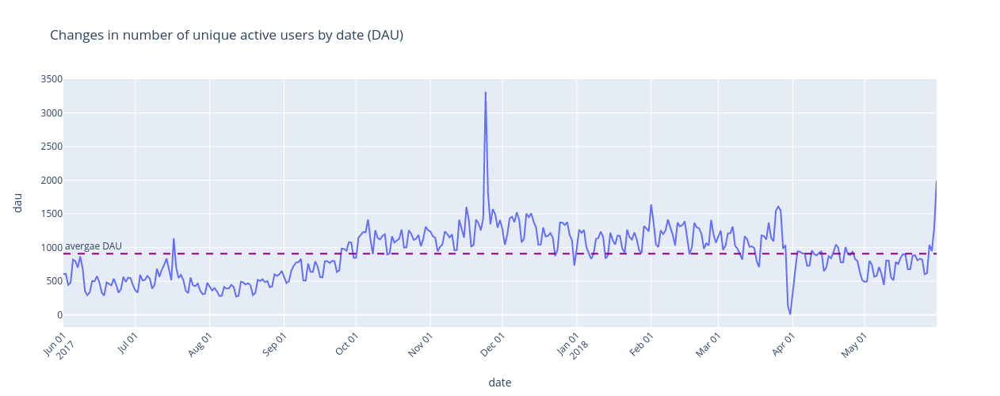

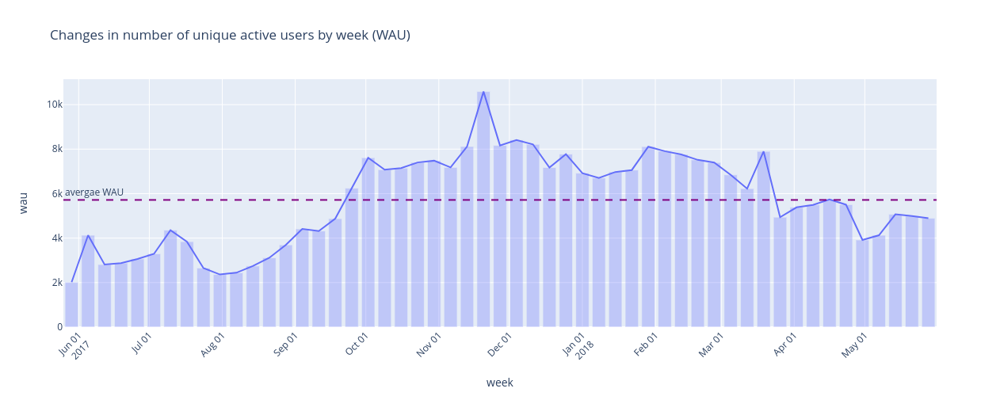

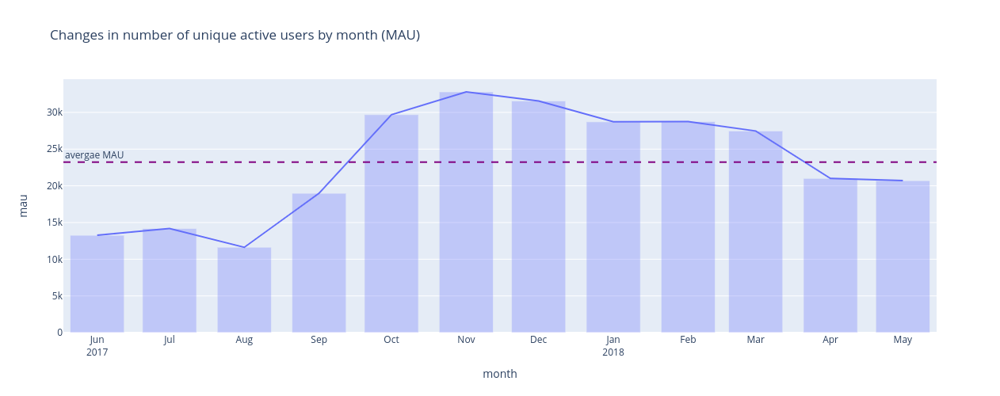

In [37]:

for metric in [dau, wau, mau]:
    x = metric.columns[0] # the time scale (i.e. 'date', 'week', or 'month')
    y = metric.columns[1] # the metric itself (DAU, MAU, or WAU)
    fig = px.line(
        metric,
        x=x,
        y=y,
        title=f'Changes in number of unique active users by {x} ({y.upper()})',
        width=1000,
        height=500,
    )
    
    # adding reference line with average active users over time
    fig.add_hline(y=metric[y].mean(),line_dash="dash", line_color="purple", annotation_text='avergae ' + y.upper(),
                 annotation_position="top left")
    
    if x == 'date':
        fig.update_xaxes(
        dtick="M1",
        tickformat="%b %d\n%Y",
        tickangle=-45,
    )
    if x == 'month' or x == 'week':
        fig2 = px.bar(
            data_frame=metric,
            x=x,
            y=y,
            opacity=0.3
            
        )
        fig.add_trace(
            fig2.data[0],
        )
        fig.data[0].update(mode='lines')
        
        fig.update_xaxes(
            dtick="M1",
            tickformat="%b\n%Y"
        )
    if x == 'week':
        fig.update_xaxes(
            tickangle=-45,
            tickformat="%b %d\n%Y", 
            showgrid=True

        )
        
  
    fig.show()

+ The active users (AU) metric reflects costumers intrest in the product, i.e. how many different people view or use our product in a given time period. 
+ All three AU metrics show a similar trend in which the number of AU is lowest during the first few months (summer of 2017), climbing upwards begining in September 2017 and peaking around the end of November 2017. Thereafter AU numbers generly decline, reaching it's lowest point by the end of the recorded period (May 2018).
+ The AU metric can have a number of varied drivers, for example: seasonal trends in costumer behaviour (e.g. changes in weather conditions, holidays), changes in marketing strategies and marketing spending, or modifications to the product itself (e.g. updates, changes in UI, etc.). In this particular case, it seems that seasonal changes may have had a significant impact on the number of AU, as these trends are generally concordant with seasonal time periods.
+ Winter period was evidently more productive in terms of attracting new customers.
+ Marketing efforts were likely also important as drivers of increase in AU numbers.
+ The week begining in Nov 20 saw a very sharp increase in AU. This week was the week of Black Friday, which may have included various deals and offers and possibly an extra marketing effort. 
+ Conversly, at the end of March 2018, the week begining on the 26th of March saw a drastic reduction in AU. One possible reason for this sharp decline in AU may have been the week long school break in the following week. Parents and other care givers may have suspended some of their plans.

### Sticky factor
Sticky factor is a measure of unique users recurrency. It reflects changes in the composition of the unique users (AU) group over a certain period of time. The more the composition of the AU group will be similar between days during a given time period, the higher the sticky factor will be. This means that users are coming back to use the product multiple times during the given time period. On the contrary, if the composition of the AU group is changing frequently, as users are mostly not combing back to use the product, then sticky factor will be high.

In [38]:
visits = visits \
        .merge(dau, on='date') \
        .merge(wau, on='week') \
        .merge(mau, on='month')

In [39]:
unique_users = pd.pivot_table(
    data=visits,
    index=[
        'month',
        'week',
        'date'
    ],
    values=[
        'dau',
        'wau',
        'mau'
    ]
)

In [40]:
unique_users['sticky_weekly'] = unique_users['dau'] / unique_users['wau']
unique_users['sticky_monthly'] = unique_users['dau'] / unique_users['mau']
unique_users = unique_users.reset_index()

In [41]:
mean_sticky_weekly = unique_users.pivot_table(
    index=['week'],
    values='sticky_weekly'
).reset_index()
mean_sticky_monthly = unique_users.pivot_table(
    index=['month'],
    values='sticky_monthly'
).reset_index()

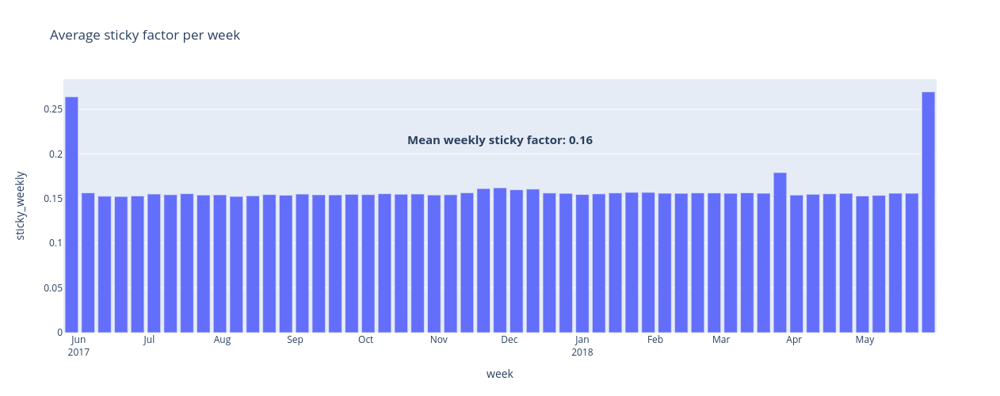

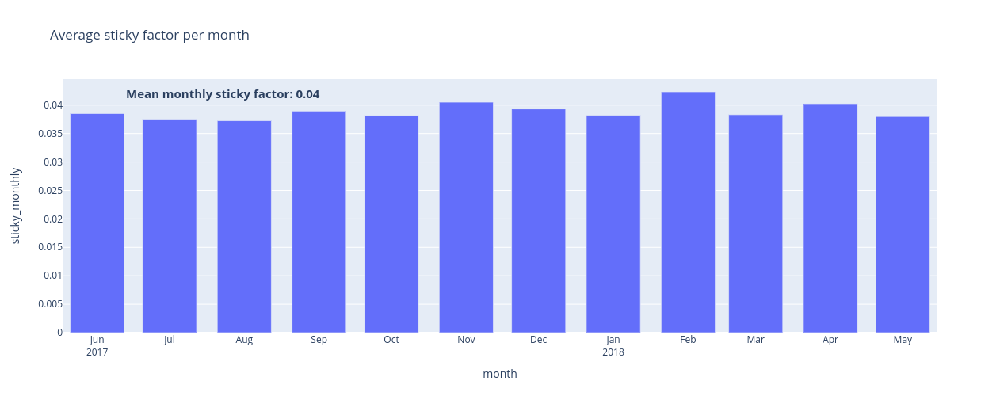

In [42]:
fig = px.bar(
        mean_sticky_weekly,
        x='week',
        y='sticky_weekly',
        title=f'Average sticky factor per week',
        width=1000,
        height=500,
    )
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y")
fig.add_annotation(
    xref='paper',
    yref='paper',
    x=0.5,
    y=0.8,
    text=f"<b>Mean weekly sticky factor: {mean_sticky_weekly['sticky_weekly'].mean():.2f}</b>",
    font=dict(
        size=15
    ),
    showarrow=False
)

fig.show()

fig = px.bar(
        mean_sticky_monthly,
        x='month',
        y='sticky_monthly',
        title=f'Average sticky factor per month',
        width=1000,
        height=500,
    )

fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y")

fig.add_annotation(
    xref='paper',
    yref='paper',
    x=0.07,
    y=0.98,
    text=f"<b>Mean monthly sticky factor: {mean_sticky_monthly['sticky_monthly'].mean():.2f}</b>",
    font=dict(
        size=15
    ),
    showarrow=False
)
fig.show()



+ Both weekly and monthly sticky factors are highly steady during the year, except for the first and last weeks of the year, where sticky factor is ~60% higher than in any other week. The later observation is most likely the result of these weeks having only 4 days, for which reason their WAU was considerably lower resulting in high sticky factor.
+ The mean weekly sticky factor is 0.16, which means that on average only 16% of weekly users are recurrent users. The mean monthly sticky factor is 4 times smaller (0.04), suggesting that as time progresses, users increasingly loose interest in the product. 


### Sessions

#### Sessions per day/week

In [43]:
# add sessions per day column to the visits DF
sessions_per_day = visits.groupby('date')['start_ts'].count()
sessions_per_day = pd.DataFrame(sessions_per_day) 
sessions_per_day = sessions_per_day.reset_index()
sessions_per_day = sessions_per_day.rename(columns={'start_ts': 'sessions_per_day'})
visits = visits.merge(sessions_per_day, on='date')


In [44]:
# add sessions per week column to the visits DF
sessions_per_week = visits.groupby('week')['start_ts'].count()
sessions_per_week = pd.DataFrame(sessions_per_week) 
sessions_per_week = sessions_per_week.reset_index()
sessions_per_week = sessions_per_week.rename(columns={'start_ts': 'sessions_per_week'})
visits = visits.merge(sessions_per_week, on='week')

In [45]:
# daily and weekly number of sessions
total_daily_sessions = visits \
        .groupby('date')['sessions_per_day'] \
        .mean().reset_index()
total_weekly_sessions = visits \
        .groupby('week')['sessions_per_week'] \
        .mean().reset_index()

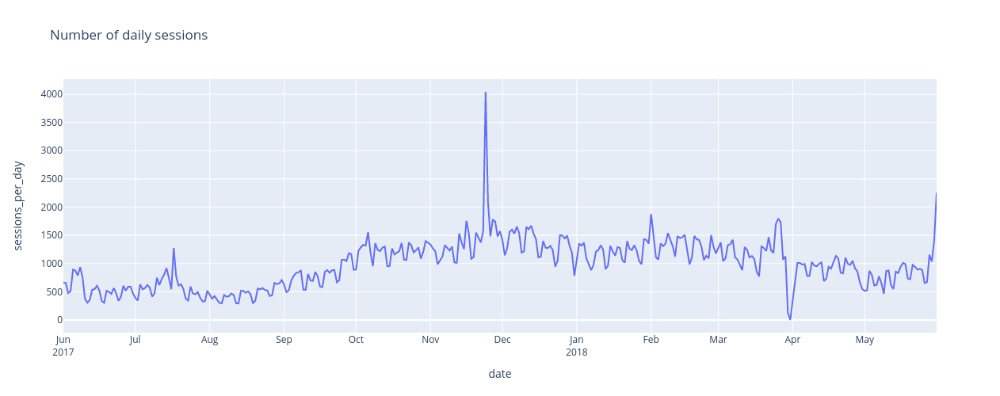

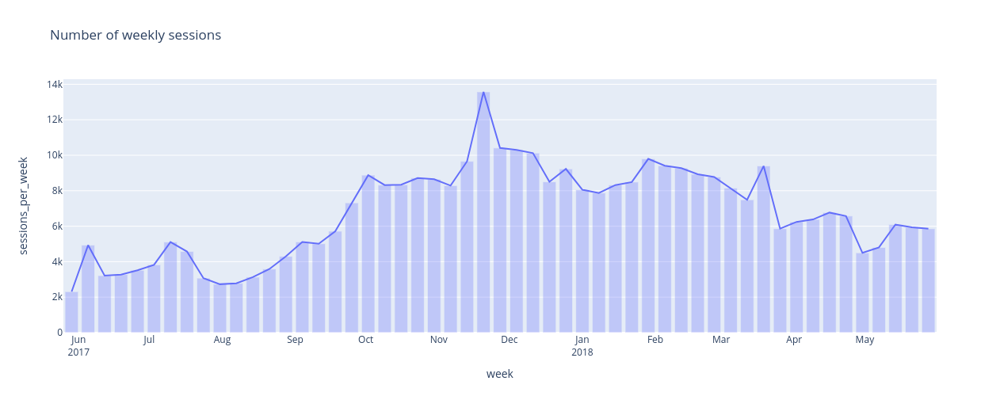

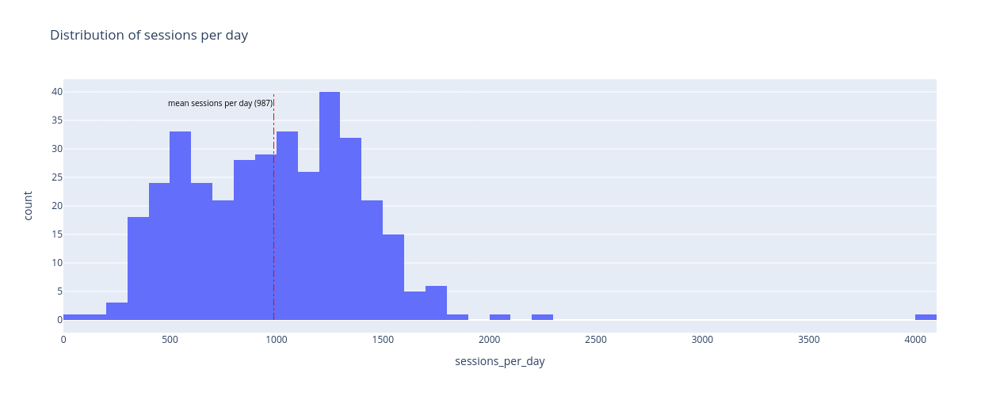

In [46]:
# dynamics of daily number of session
fig = px.scatter(
        total_daily_sessions,
        x='date',
        y='sessions_per_day',
        title=f'Number of daily sessions',
        width=1000,
        height=500,
)
fig.data[0].update(mode='lines')

fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y")

fig.show()

# dynamics of weekly number of session
fig = px.scatter(
        total_weekly_sessions,
        x='week',
        y='sessions_per_week',
        title=f'Number of weekly sessions',
        width=1000,
        height=500,
)
fig.data[0].update(mode='lines')

# x-ticks
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y")

# add bars in the background
fig2 = px.bar(
    data_frame=total_weekly_sessions,
    x='week',
    y='sessions_per_week',
    opacity=0.3
)
fig.add_trace(
    fig2.data[0],
)

fig.show()

# distribution of total sessions per day
fig = px.histogram(
        visits.groupby('date')['sessions_per_day'].mean(),
        x='sessions_per_day',
        title=f'Distribution of sessions per day',
        width=1000,
        height=500,
    )

# add dotted line for mean number of sessions per day
mean_sessions_per_day = total_daily_sessions['sessions_per_day'].mean()
fig.add_trace(
    go.Scatter(
        x=[mean_sessions_per_day, mean_sessions_per_day],
        y=np.linspace(0, 40, 2),
        line=dict(
            color='red',
            width=1,
            dash='dashdot'
        ),
        mode='lines',
        showlegend=False,        
    )
)
# annotate dotted mean line
x_shift=5
y_shift=10
fig.add_annotation(
    text=f'mean sessions per day ({mean_sessions_per_day:.0f})',
    x=mean_sessions_per_day,
    y=38,
    showarrow=False,
    font=dict(
        color='black',
        size=10
    ),
    xanchor='right',
    
)

fig.show()


+ Number of daily and weekly sessions follows a similar trend as that of AU dynamics.
+ The mean number of daily sessions is 987 sessions. 

#### Sessions per user

In [47]:
# compute weekly sessions per user
visits['weekly_sessions_per_user'] = visits['sessions_per_week'] / visits['wau']

In [48]:
# mean weekly sessions per user
weekly_sessions_per_user = \
        visits.groupby('week')['weekly_sessions_per_user'] \
        .mean().reset_index()


In [49]:
mean_weekly_sessions_per_user = (
    weekly_sessions_per_user
    ['weekly_sessions_per_user']
    .mean()
)

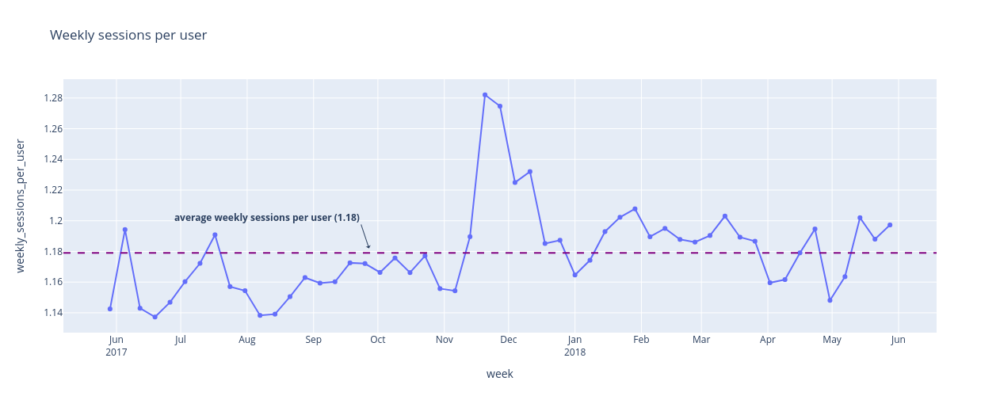

In [50]:

# average number of sessions per week per user
fig = px.scatter(
        weekly_sessions_per_user,
        x='week',
        y='weekly_sessions_per_user',
        title=f'Weekly sessions per user',
        width=1000,
        height=500,
)
fig.data[0].update(mode='lines+markers')

fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y")

# adding reference line with average active users over time
fig.add_hline(
    y=mean_weekly_sessions_per_user,
    line_dash="dash",
    line_color="purple",
    annotation=dict(
        text=(
        f"<b>average weekly sessions per user "
        f"({mean_weekly_sessions_per_user:.2f})</b>"
        ),
        xref='paper',
        x=0.35,
        y=1.182,
        showarrow=True,
        arrowhead=1
    )
)
 
fig.show()

print()


+ The number of weekly sessions per user is almost constant throughout the recorded period. 

#### Session length

In [51]:
# session length in minutes
visits['session_minutes'] = (
    (visits['end_ts'] - visits['start_ts']) / np.timedelta64(1, 'm')
)

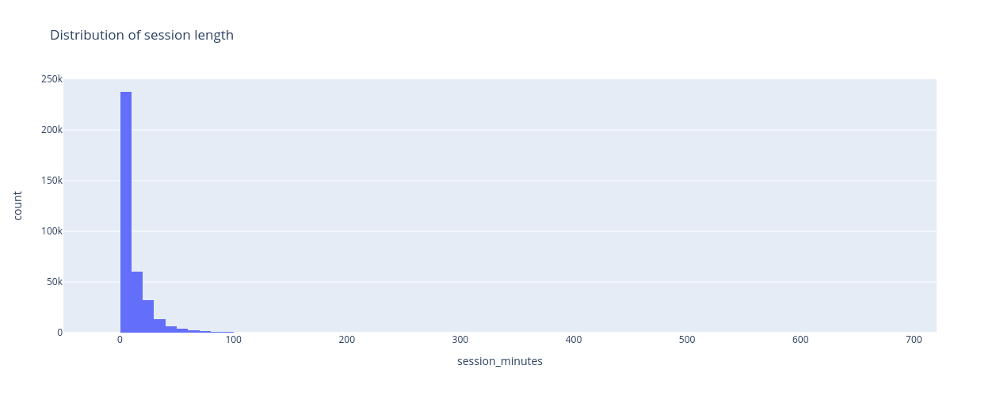

In [52]:
fig_hist = px.histogram(
    visits,
    x="session_minutes",
    title='Distribution of session length',
    nbins=100,
    width=1000,
    height=500
)
fig_hist.show()


In [53]:
# mean session length per day
session_minutes_per_day = pd.pivot_table(
    data=visits,
    index=['date'],
    values='session_minutes',
    aggfunc='mean'
).reset_index()

In [54]:
# divide daily average session length into bins 
NBINS = 5
session_minutes_per_day['bins'] = pd.cut(
    session_minutes_per_day['session_minutes'],
    NBINS
)

# count the number of sessions within each bin
bin_count = session_minutes_per_day.groupby('bins')['date'].count()
bin_count = bin_count.reset_index()
bin_count = bin_count.rename(columns={'date': 'bin_count'})

# merge sessions lengths per day with bin count
session_minutes_per_day = session_minutes_per_day.merge(bin_count, on='bins', how='left')
session_minutes_per_day['bins'] = session_minutes_per_day['bins'].astype('str')

In [55]:
# group by day for plotting
binned_average_session_length_per_day = \
        session_minutes_per_day.groupby('bins').mean().reset_index()

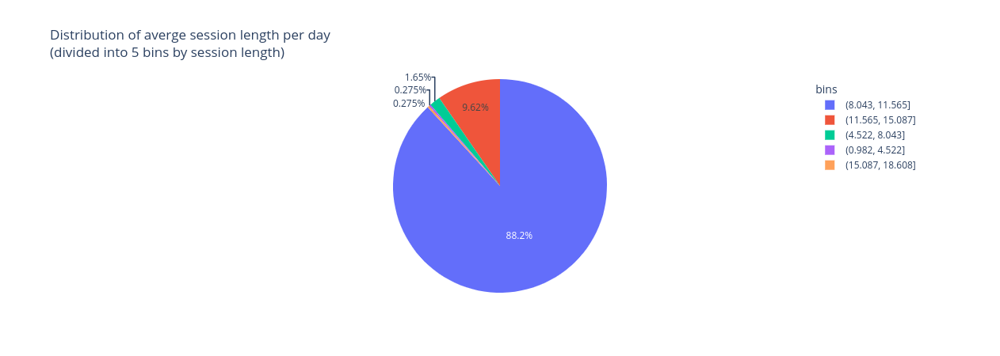

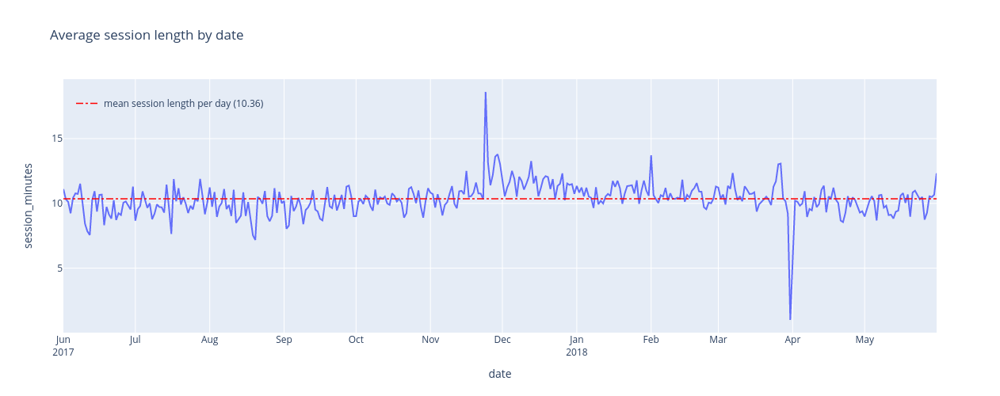

In [56]:
# pie chart of daily average session length, divided into bins
fig = px.pie(
    binned_average_session_length_per_day,
    values='bin_count',
    names='bins',
    title=f'Distribution of averge session length per day <br>(divided into {NBINS} bins by session length)',
    height=450,
    width=450
)

fig.update_layout(
    legend=dict(
        title='bins'
    )
)
fig.show()

# plot session length by date
fig = px.scatter(
        session_minutes_per_day,
        x='date',
        y='session_minutes',
        title=f'Average session length by date',
        width=1000,
        height=500,

    )

# dotted line for mean number of sessions per day
mean_sessions_per_day = \
        session_minutes_per_day['session_minutes'].mean()
fig.add_trace(
    go.Scatter(
        name=f'mean session length per day ({mean_sessions_per_day:.2f})',
        x=[fig.data[0]['x'][0], fig.data[0]['x'][-1]],
        y=[mean_sessions_per_day, mean_sessions_per_day],
        line=dict(
            dash="dashdot",
            color="red",
            width=1.5
        ),
        mode='lines'
    )
)

# legend
fig.update_layout(
    legend=dict(
        x=0.01,
        y=0.95,
        bgcolor='rgba(0,0,0,0)',
    )
)

# plot as line
fig.update_traces(
    mode='lines'
)

# ticks
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y")
fig.show()

+ The average sessions length was 10.36 minutes.
+ Daily average session length varies moderatly around the mean daily session length, excepting a sharp peak during the last week of November 2017 (mentioned earlier in the context of AU dynamics), and a sharp downwards peak around the end of March 2018. The former is likely associated with similar drivers as with AU dynamics (Black Friday week?).
+ The sharp decrease in average session length during the end of March 2018, must be associated with some exceptional event, either from the public sphere, or otherwise related to the product itself (e.g. a problem with the platform, introduction of a new feature that complicated the use of the platform).

### Retention

#### Monthly cohorts

In [57]:
# find first activity month (to set cohorts by)
first_activity_month = visits.groupby('uid')['month'].min()
first_activity_month.name = 'first_activity_month'
visits = visits.join(first_activity_month, on='uid')

visits['cohort_month'] = visits['month'] - visits['first_activity_month']
visits['cohort_month'] = (visits['cohort_month' ] / np.timedelta64(1, 'M')).round()
visits['cohort_month'] = visits['cohort_month'].astype(int)

In [58]:
# number of users for each cohort in each month
cohorts = (
    visits.groupby(['first_activity_month', 'cohort_month'])
    .agg({'uid': 'nunique'})
    .reset_index()
) 
 
# number of initial users in each cohort
initial_users_count = cohorts[cohorts['cohort_month'] == 0] \
                                    [['first_activity_month', 'uid']]
initial_users_count = initial_users_count \
                    .rename(columns={'uid': 'initial_cohort_users'})

# merge initial user count with cohorts DF
cohorts = cohorts.merge(
    initial_users_count,
    on='first_activity_month'
) 

# calculate retention
cohorts['retention'] = cohorts['uid'] \
               / cohorts['initial_cohort_users'] 

# rename columns
renaming_map = {
    'first_activity_month': 'cohort',
    'cohort_month': 'cohort_cycle'
}
cohorts = cohorts.rename(columns=renaming_map)

In [59]:
# pivot table with retention rate per cohort per month
retention_pivot = cohorts.pivot_table(
    index='cohort',
    columns='cohort_cycle',
    values='retention',
    aggfunc='mean',
)

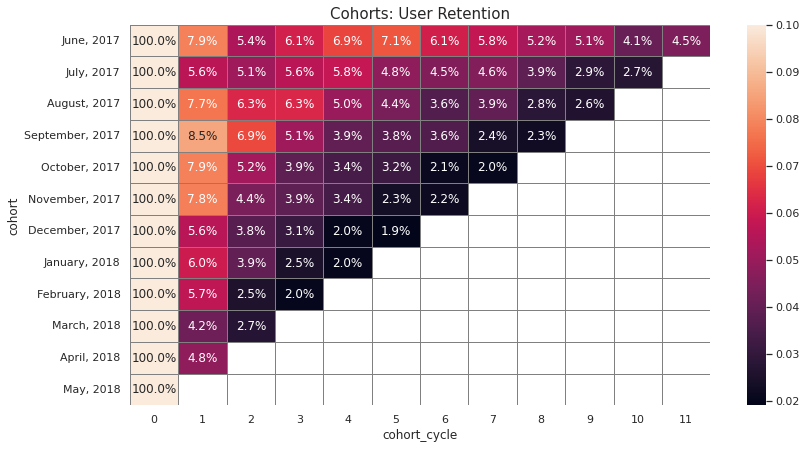

In [60]:
sns.set(style='white')
plt.figure(figsize=(13, 7))
plt.title(
    'Cohorts: User Retention',
    size=15
)
sns.heatmap(
    retention_pivot,
    annot=True,
    fmt='.1%',
    linewidths=1,
    linecolor='gray',
    vmax=0.1,
    yticklabels=retention_pivot.index.strftime('%B, %Y'),
#     cmap='Blues'
);

+ Cohort retention values decrease with cohort age.
+ The rate of decrease is clearly increased with cohort initial date (i.e. early cohort's retention rates drop more slowly with cohort age)
+ The success of early cohorts in terms of customer retention, particularly the first and third cohorts (June and August 2017 respectivly), shold point our attention to the conditions - in terms of marketing, product features and other possibly external factors - during the initial time period of these cohorts.
+ Better retention rates are most reasonably assocaited with initial consumer satisfaction, which in turn could be related to a number of reasons, both product and marketing related as well as external factors.

### Conclusions

+ Active users numbers increased considerably during winter months and peaked at the end of November 2017 (in conjunction with Black Friday week).
+ Weekly sticky factor (average 0.16) was 4 times higher than monthly sticky factor reflecting users intrest span in the product.
+ The average number of daily or weekly sessions follows a similar trend as that of AU numbers, indicating the number of sessions is mostly a factor of the number of unique users.
+ The above is further supported by the steady number of weekly sessions per user, constant at ~1.2 sessions throughour the year.
+ Users mostly spend around 10 minutes per session.
+ Retention rates are lower than 10% right after the first activity month for all cohorts. 
+ User retention rates decrease considerably with time and the rate of decrease is notebly higher as the initial cohort date is more recent (i.e. Retention decreases more rapidly for later cohorts)
+ The June 2017 cohort stands out in terms of retention rates. 

## Sales
    - When do people start buying?
    - How many orders do they make during a given period of time?
    - What is the average purchase size?
    - How much money do they bring? (LTV)

### Conversion

#### Time to conversion

In [61]:
# find first order timestamp
first_orders = orders.groupby('uid')['buy_ts'].min().reset_index()
first_orders = first_orders.rename(columns={'buy_ts': 'first_order_ts'})

# merge first order time with visits
visits = visits.merge(first_orders, on='uid')

# find first session timestamp
first_session_ts = visits.groupby('uid')['start_ts'].min()
first_session_ts.name = 'first_session_ts'

# merge first session with visits
visits = visits.join(first_session_ts, on='uid')

# calculate time to conversion
visits['time_to_conversion'] = visits['first_order_ts'] - visits['first_session_ts']
visits['time_to_conversion'] = (visits['time_to_conversion'] / np.timedelta64(1, 'D'))

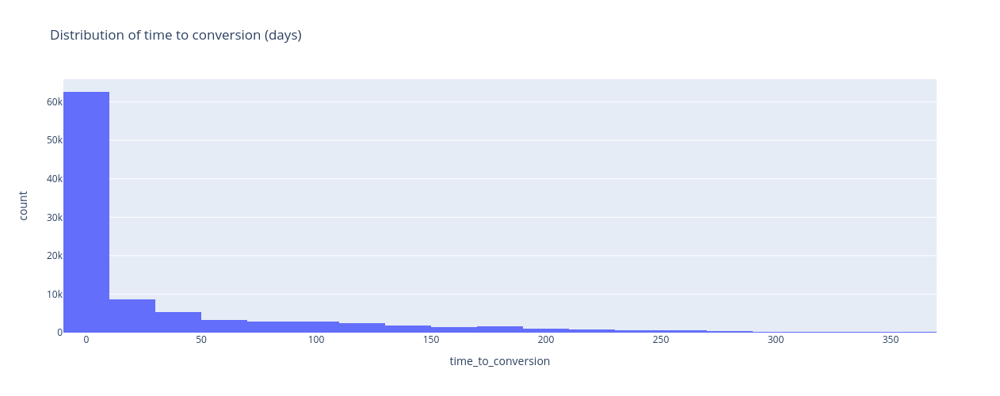

In [62]:
fig = px.histogram(
    visits,
    x="time_to_conversion",
    title='Distribution of time to conversion (days)',
    nbins=35,
    height=500
)
fig.show()

In [63]:
print(f"Median time to conversion: {visits.time_to_conversion.median():.0f} day")

Median time to conversion: 1 day


+ Large majority of users convert after less than 10 days
+ On average, conversion takes place 1 day after first session (visit)

<!-- try to divide the distribution into bins and then plot histograms -->

### Repeating purchases 
Look at the rate with which users are returning to place new orders in a given time period.
<!-- How many orders do they make during a given period of time? -->

In [64]:
# column by which to calculate monthly purchases
orders['month'] = orders.buy_ts.astype('datetime64[M]')

In [65]:
# find first order month for each user
first_order_month = orders.groupby('uid')['buy_ts'].min().reset_index()
first_order_month['first_order_month'] = first_order_month['buy_ts'].astype('datetime64[M]')
first_order_month = first_order_month.drop('buy_ts', axis=1)
first_order_month.name = 'first_order_month'

# merge first order month with orders
orders = orders.merge(first_order_month, on='uid')

In [66]:
# number of users for each cohort in the first order month
cohort_size = orders \
        .groupby('first_order_month') \
        .agg({'uid': 'nunique'})
cohort_size = cohort_size \
        .drop(np.datetime64('2018-06-01')).reset_index()
cohort_size = cohort_size.rename(
    columns={'uid': 'cohort_size'}
)

# number of orders per cohort per month
cohorts = orders \
    .groupby(['first_order_month','month'])['buy_ts'] \
    .count().reset_index()

In [67]:
cohorts.columns=[
    'first_order_month',
    'month',
    'orders'
]

# merge cohorts and cohort sizes
cohorts = cohorts.merge(cohort_size,on=['first_order_month'])

# convert months to cohort liftime cycle
cohorts['cycle'] =(cohorts['month'] - cohorts['first_order_month'])
cohorts['cycle'] = (cohorts['cycle'] / np.timedelta64(1,'M'))
cohorts['cycle'] = cohorts['cycle'].round().astype('int')

In [68]:
# orders per user for each month (cohort cycle)
cohorts['orders_per_user']=cohorts['orders']/cohorts['cohort_size']


In [69]:
cohorts = cohorts.rename(
    columns={
        'first_order_month': 'cohort',
    }
)

In [70]:
# pivot table with number of purchases per user per cohort per cohort cycle 
orders_per_buyer_pivot = cohorts.pivot_table(
    index='cohort',
    columns='cycle',
    values='orders_per_user'
)

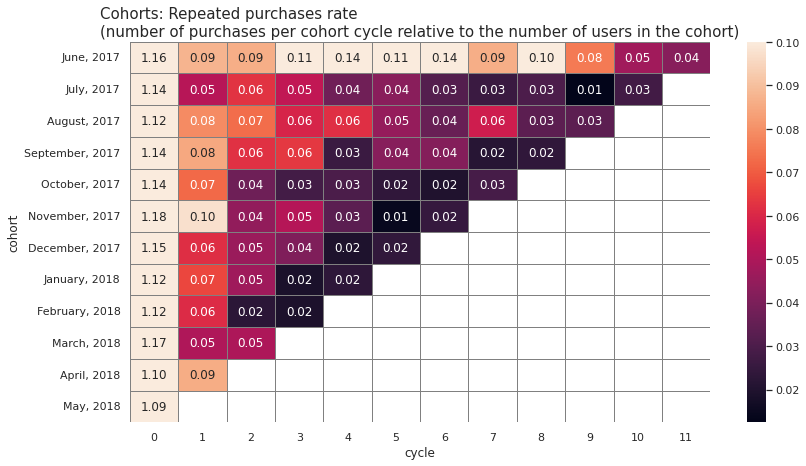

In [71]:
sns.set(style='white')
plt.figure(figsize=(13, 7))
plt.title(
    'Cohorts: Repeated purchases rate\n(number of purchases per cohort cycle relative to the number of users in the cohort)',
    size=15,
    ma='left'
)
sns.heatmap(
    orders_per_buyer_pivot,
    annot=True,
    fmt='.2f',
    linewidths=1,
    linecolor='gray',
    vmax=0.1,
    yticklabels=orders_per_buyer_pivot.index.strftime('%B, %Y')
);


+ The first cohort (June, 2017) had expetionaly high rates of repeating purchases throughout most of the year, relative to the other cohorts. 
+ Repeated purchases rate typically decreas as cohort age (cycles) increases.
+ Repeating purchases rate were allways lower than 10%, excepting the June 2017 cohort which had reached repeating purchases rates close to 15% during the middle of the time period. 

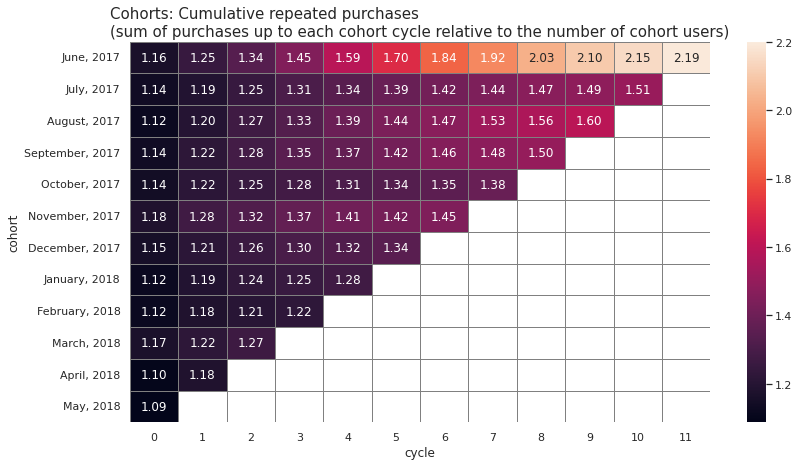

In [72]:
# cumulative orders per user per cohort
sns.set(style='white')
plt.figure(figsize=(13, 7))
plt.title(
    'Cohorts: Cumulative repeated purchases\n(sum of purchases up to each cohort cycle relative to the number of cohort users)',
    size=15,
    ma='left'
        
)
sns.heatmap(
    orders_per_buyer_pivot.cumsum(axis=1),
    vmax=2.2,
    annot=True,
    fmt='.2f',
    linewidths=1,
    linecolor='gray',
    yticklabels=orders_per_buyer_pivot.index.strftime('%B, %Y')
);



+ The June cohort stands out.
+ Other cohorts can generaly be grouped together in terms of the increase rate in cumulative orders per user.

### Purchase size

#### Distribution

In [73]:
# sum of checkout per user per buy
purchase_size = orders \
    .groupby(['uid', 'buy_ts'])['revenue'] \
    .sum().reset_index()
purchase_size.rename(
    columns={
        'revenue': 'sum_revenue'
    },
    inplace=True
)

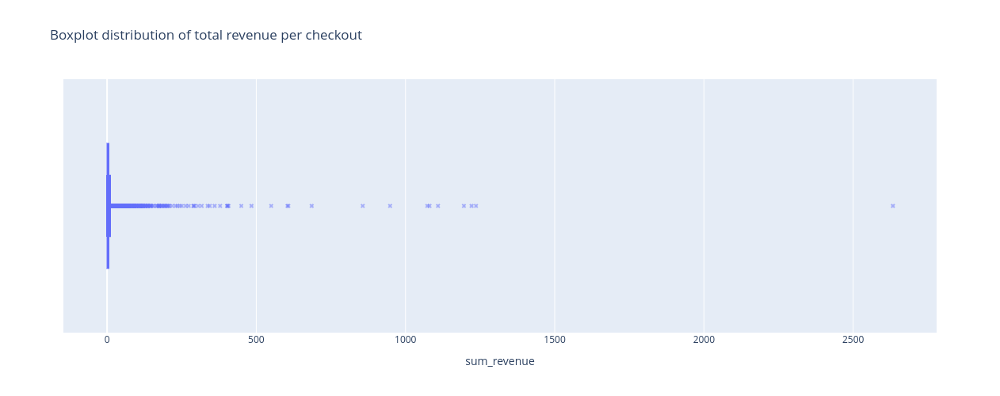

In [74]:
fig = px.box(
    purchase_size,
    x="sum_revenue",
    title='Boxplot distribution of total revenue per checkout',
#     nbins=10000,
#     range_x=(0, 100),
    height=500
)

fig.update_traces(
    marker=dict(
        size=5,
        opacity=0.5,
        symbol='x'
    )
)
fig.show()

In [75]:
# mean and median of checkout sum
median_purchase_size = purchase_size.sum_revenue.median()
mean_purchase_size = purchase_size.sum_revenue.mean()

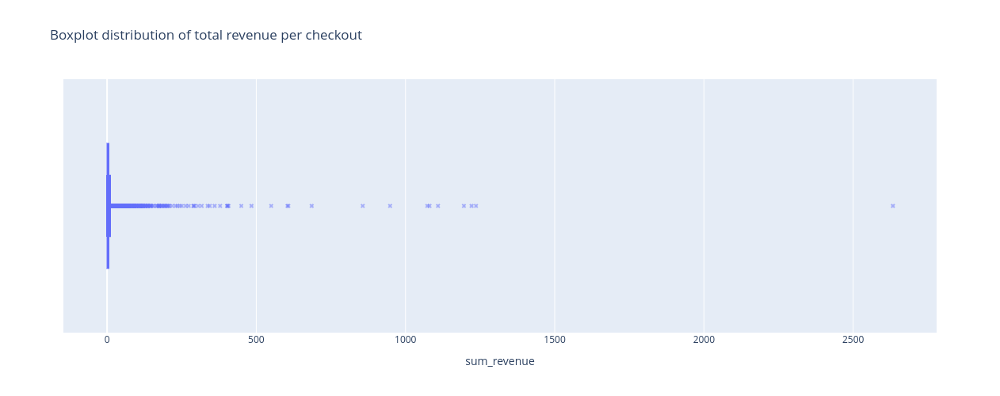

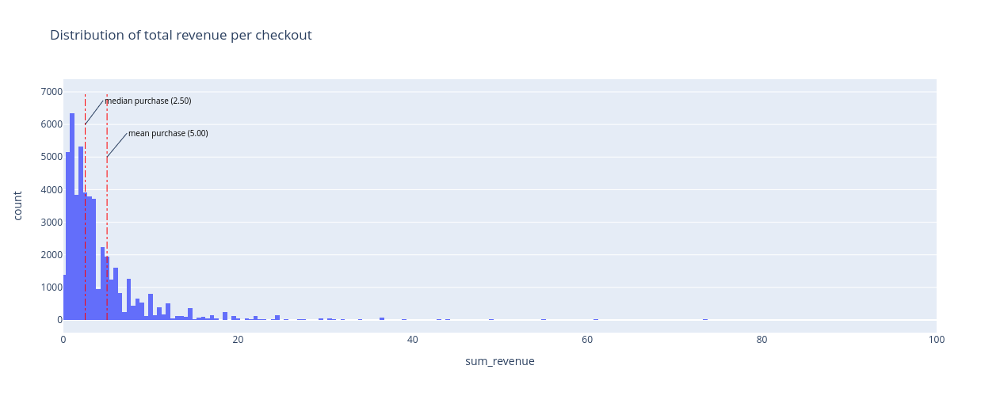

In [76]:
# boxplot distribution
fig = px.box(
    purchase_size,
    x="sum_revenue",
    title='Boxplot distribution of total revenue per checkout',
    height=500
)

fig.update_traces(
    marker=dict(
        size=5,
        opacity=0.5,
        symbol='x'
    )
)
fig.show()

# distribution of checkout sums over all checkouts
fig = px.histogram(
    purchase_size,
    x="sum_revenue",
    title='Distribution of total revenue per checkout\n',
    nbins=10000,
    range_x=(0, 100),
    height=500,
)
# add vertical line with median purchase size
fig.add_trace(
    go.Scatter(
        x=[median_purchase_size, median_purchase_size],
        y=np.linspace(0, 7000, 2),
        line=dict(
            color='red',
            width=1,
            dash='dashdot'
        ),
        mode='lines',
        showlegend=False,        
    )
)

# add vertical line with mean purchase size
fig.add_trace(
    go.Scatter(
        x=[mean_purchase_size, mean_purchase_size],
        y=np.linspace(0, 7000, 2),
        line=dict(
            color='red',
            width=1,
            dash='dashdot'
        ),
        mode='lines',
        showlegend=False,        
    )
)

# annotations for mean and median
x_shift=5
y_shift=1000
fig.add_annotation(
    text=f'median purchase ({median_purchase_size:.2f})',
    x=median_purchase_size,
    y=6000,
    ax=median_purchase_size + x_shift*4,
    font=dict(
        color='black',
        size=10
    ),
    xanchor='left',
)
fig.add_annotation(
    text=f'mean purchase ({mean_purchase_size:.2f})',
    x=mean_purchase_size,
    y=5000,
    ax=mean_purchase_size + x_shift*4,
    font=dict(
        color='black',
        size=10
    ),
    xanchor='left',
    
)
fig.show()

In [77]:
# find distribution of checkout sums in relation to threshold
threshold = 10
groupby_purchase_size = purchase_size.groupby(
    purchase_size.apply(
        lambda row: True if row['sum_revenue'] < threshold else False, axis=1
    )
)
total_revnue_per_group = \
        groupby_purchase_size.agg(
    { 'buy_ts': 'count', 'sum_revenue': 'sum'}
)


total_revnue_per_group = total_revnue_per_group.reset_index()
total_revnue_per_group.rename(columns={'index': f'lower_than_{threshold}_$', 'buy_ts': 'number_of_checkouts'})

,lower_than_10_$,number_of_checkouts,sum_revenue
0,False,4165,113771.406250
1,True,46250,138285.796875


+ Distribution of total revenue per checkout is heavily right skewed with many high outliers.
+ The large majority of checkouts are of a total less than 10 \$.
+ Despite that, the total revenue from checkouts higher than 10 amounts to almost half of the entire sum of checkouts. Indicating that although high-revenue checkouts are more rare they can contribute a major share of the total revenue. 

#### Cohort analysis, purchase size

In [78]:
# mean revenue per cohort per month
cohorts = orders \
        .groupby(['first_order_month','month'])['revenue'] \
        .mean().reset_index()

# cohort age
cohorts['cohort_cycle'] = (
    cohorts['month'] - cohorts['first_order_month']
)
cohorts['cohort_cycle'] = \
        (cohorts['cohort_cycle'] / np.timedelta64(1,'M'))
cohorts['cohort_cycle'] = \
        cohorts['cohort_cycle'].round().astype('int')


In [79]:
# pivot with mean revenue per cohort per cohort cycle
cohorts_pivot = cohorts.pivot_table(
    index='first_order_month', 
    columns='cohort_cycle', 
    values='revenue', 
    aggfunc='mean'
)


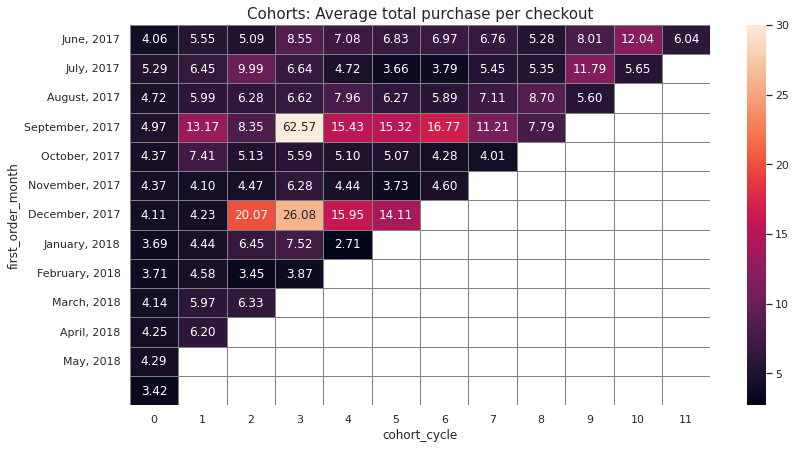

In [80]:
# plot cohort analysis
sns.set(style='white')
plt.figure(figsize=(13, 7))
plt.title(
    'Cohorts: Average total purchase per checkout',
    size=15
)
sns.heatmap(
    cohorts_pivot,
    vmax=30,#cohorts_pivot.max().max(),
    vmin=cohorts_pivot.min().min(),
    annot=True,
    fmt='.2f',
    linewidths=1,
    linecolor='gray',
    yticklabels=orders_per_buyer_pivot.index.strftime('%B, %Y')
);


+ Average checkout sum is mostly relatively constant.
+ The September 2017 cohort and the cohort of December 2017 are exeptions in that sense, with significantly higher averages starting from the 3rd or 4th cohort cycle.

### Life Time Value (LTV)
Average total revenue per user in a given time period. \

Here we will perform chorot analysis using first order month as our cohorts and monthly periods as our cohort cycles (lifetime).
For each cohort and each month we calculate the total revenue and divide it by the initial number of users in the cohort to yield the average revenue per user in a given month and cohort. \
Then we plot the cumulative sum of these average total revnue values along the time scale, which allows us to examine the time it takes an average user in a given cohort to produce a certain limit or quata of revenue. 

In [81]:
# total revenue per cohort per month
ltv_cohorts = orders.groupby(['first_order_month','month'])['revenue'].sum().reset_index()
ltv_cohorts.columns = ['first_order_month','month','revenue']

In [82]:
# cohort sizes, number of users for each cohort in the first order month
cohort_size = orders \
        .groupby('first_order_month') \
        .agg({'uid': 'nunique'})

cohort_size = cohort_size \
        .drop(np.datetime64('2018-06-01')).reset_index()
cohort_size = cohort_size.rename(
    columns={'uid': 'cohort_size'}
)

In [83]:
# merge ltv_cohorts with the cohort size
ltv_cohorts = ltv_cohorts.merge(cohort_size, on=['first_order_month'])

# cohort age
ltv_cohorts['cycle'] = (ltv_cohorts['month'] - ltv_cohorts['first_order_month'])
ltv_cohorts['cycle'] = (
    ltv_cohorts['cycle']/ np.timedelta64(1,'M')
)
ltv_cohorts['cycle'] = ltv_cohorts['cycle'].round().astype('int')

# compute LTV, revenue per cohort user
ltv_cohorts['ltv'] = ltv_cohorts['revenue'] / ltv_cohorts['cohort_size']


In [84]:
# pivot ltv, revenue per user per cohort per cohort cycle
ltv_cohort_pivot = ltv_cohorts.pivot_table(
    index='first_order_month', 
    columns='cycle', 
    values='ltv', 
    aggfunc='sum'
)

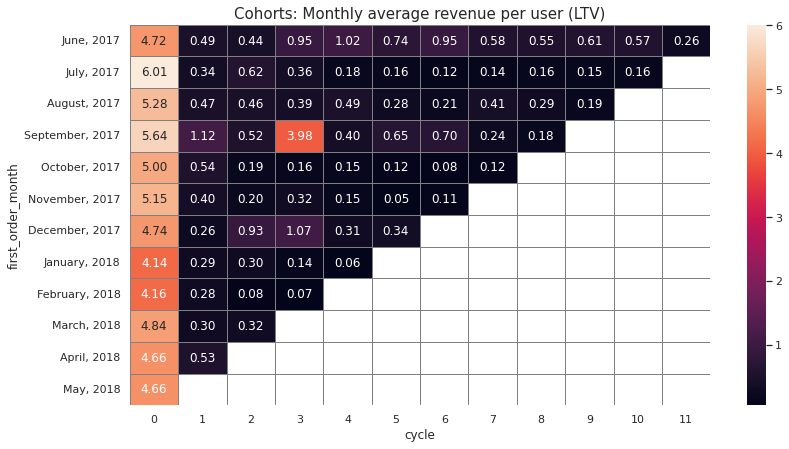

In [85]:
sns.set(style='white')
plt.figure(figsize=(13, 7))
plt.title(
    'Cohorts: Monthly average revenue per user (LTV)',
    size=15,
)
sns.heatmap(
    ltv_cohort_pivot,
    annot=True,
    fmt='.2f',
    linewidths=1,
    linecolor='gray',
    yticklabels=orders_per_buyer_pivot.index.strftime('%B, %Y')
);


In [86]:
# cumulative ltv
cumulative_ltv = ltv_cohort_pivot.cumsum(axis=1)

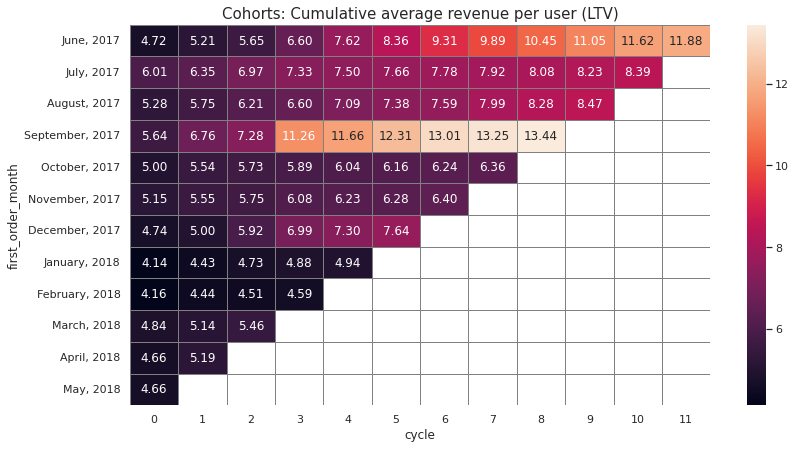

In [87]:
sns.set(style='white')
plt.figure(figsize=(13, 7))
plt.title(
    'Cohorts: Cumulative average revenue per user (LTV)',
    size=15,
)
sns.heatmap(
    cumulative_ltv,
    annot=True,
    fmt='.2f',
    linewidths=1,
    linecolor='gray',
    yticklabels=orders_per_buyer_pivot.index.strftime('%B, %Y')
);


+ A typical user will produce a cumulative revenue of between ~6-8 \$ after 4 cohort cycle, excepting the September 2017 cohort where a cumulative revenue of more than 11 \\$ is expected allready after 3 cohort cycles.
+ The June 2017 cohort also stands out, as its users reached on average, a cumulative LTV of ~11 \$ after only 3 life cycles.

## Marketing
How much money was spent? Overall/per source/over time
How much did customer acquisition from each of the sources cost?
How worthwhile where the investments? (ROI)
Plot graphs to display how these metrics differ for various devices and ad sources and how they change in time.



In [88]:
# sorting cost for futher visualization
costs = costs.sort_values(by=['dt','source_id'])

# add month column
costs['month'] = costs.dt.astype('datetime64[M]')

In [89]:
print()
print('Total marketing cost is {}$'.format(costs['costs'].sum()))
print()


Total marketing cost is 329131.625$



### Costs per source

In [90]:
total_costs_per_source = (
    costs.groupby(['source_id'])['costs']
    .sum().reset_index()
)
costs_per_month = (
    costs.groupby(['source_id','month'])['costs']
    .sum().reset_index()
)

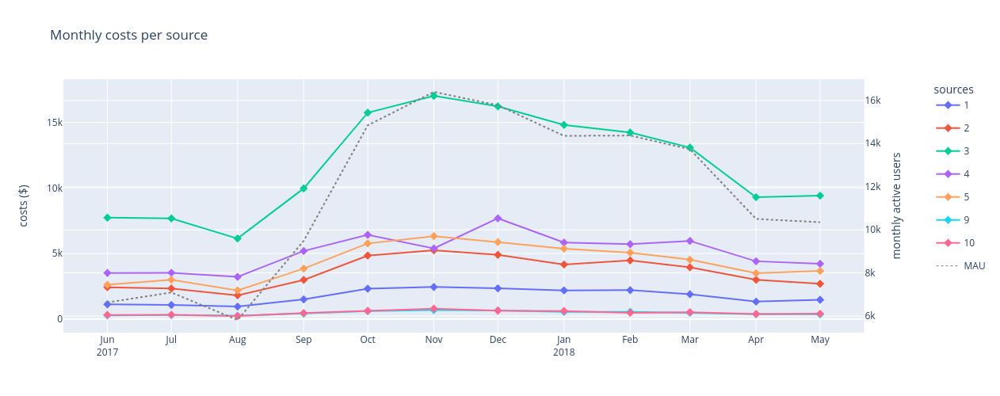

In [91]:
#Create figure with secondary y-axis
fig = make_subplots(
    specs=[[{"secondary_y": True}]]
)

# costs per month per source
costs_per_month_object = px.line(
    costs_per_month,
    x="month",
    y="costs",
    color='source_id',
    height=500,
    title='Marketing costs per source per month'
)

# add traces
for trace in costs_per_month_object.data:
    fig.add_trace(
        go.Scatter(
            arg=trace,
            mode='lines+markers',
            marker=dict(
                size=8,
                symbol='diamond'
            ),
        ),
        secondary_y=False
    )


# normalize MAU
mau_normalized = mau.copy()
mau_normalized['mau'] = mau_normalized['mau'] / 2

# add trace (a dotted line for MAU)
# mau_scatter_object = (
#     px.scatter(
#         mau_normalized,
#         x='month',
#         y='mau',
#     )
#     .data[0]
# )
mau_scatter_object = go.Scatter(
    arg=px.scatter(
        mau_normalized,
        x='month',
        y='mau',
    ).data[0],
    mode='lines',
    line=dict(
        color='grey',
        dash='dot'
    ),
    text='foo'
)
fig.add_trace(
    mau_scatter_object,
    secondary_y=True
)

# ylables
fig.update_yaxes(
    title_text="costs ($)",
    secondary_y=False
)
fig.update_yaxes(
    title_text="monthly active users",
    secondary_y=True,
)

# ticks
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y")


# legend entry for MAU
fig.add_trace(
    go.Scatter(
        x=[None],
        y=[None],
        mode='lines',
        line=dict(
            width=1,
            color=(
                mau_scatter_object
                ['line_color']
            ),
            dash='dot'
        ),
        legendgroup='mean',
        showlegend=True,
        name='MAU'
    )
)

# layout
fig.update_layout(
    height=500,
    legend_title='sources',
    title_text='Monthly costs per source'
)

fig.show()

+ Costs where low in the begining and end of the year, typically rising cosiderably between August and November and then decreasing once more until April.
+ Marketing costs dynamics clearly correspond with MAU dynamics, expressing the expected relation between the two metrics. This correlation is particularly apparent for source 3.
+ Source 3 is by far the highest in terms of costs throughout the year, showing a dramtic increase in costs during peak months (Augo.
+ Sources 4, 5 and 2 have similar, medium range costs throughout the year. 
+ Source 9 and 10 are the lowest in terms of costs and show very little fluctuation in costs.
+ Source 1 is slightly higher in costs compared with the two lowest sources, showing only slight increase in costs during the peak period typical for all other sources (August-April).

### Customer acquisition cost (CAC)

#### CAC per month

In [92]:
# total marketing costs per month
costs_per_month = costs.groupby(['month'])['costs'].sum().reset_index()

In [93]:
# number of new costumers aquired per month
new_customers_per_month = orders \
        .groupby(['first_order_month'])['uid'] \
        .nunique()
new_customers_per_month = new_customers_per_month \
        .drop(np.datetime64('2018-06-01'))
new_customers_per_month = new_customers_per_month.reset_index()
new_customers_per_month.columns = [
    'month',
    'users'
]


In [94]:
# acquisition cots per user per month
cac_per_month = costs_per_month.merge(
    new_customers_per_month,
    how='left',
    on='month'
)
cac_per_month['cac'] = \
    cac_per_month['costs'] \
    / cac_per_month['users']


In [95]:
# normalize monthly acquired customers to the mean and multiply by monthly mean CAC

cac_per_month['norm_users'] = (
    cac_per_month['users'] 
    / cac_per_month['users'].mean()
    * cac_per_month['cac'].mean()
)


In [96]:
# total cost by month normalized to mean costs
costs_by_month = \
        costs.groupby('month')['costs'] \
        .sum().reset_index()
costs_by_month['costs'] = (
        costs_by_month['costs'] \
        / costs_by_month['costs'].mean() \
        * cac_per_month['cac'].mean()
)

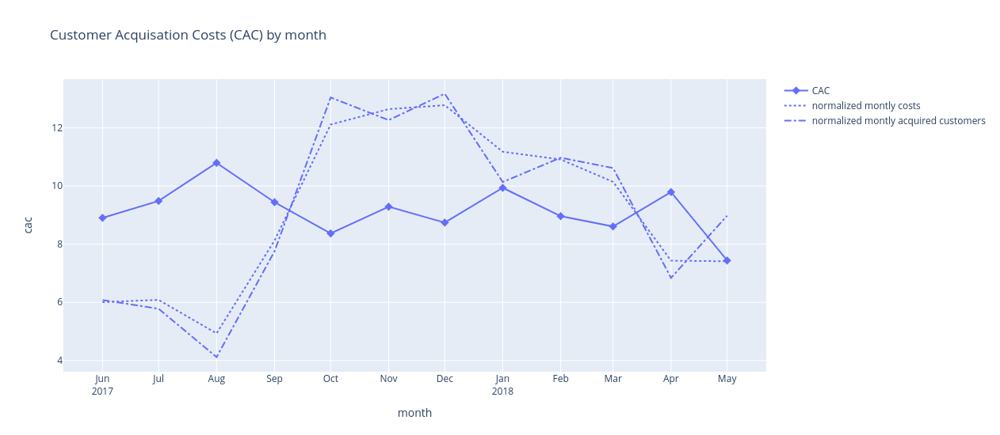

In [97]:
fig = px.line(
    cac_per_month,
    x="month",
    y="cac",
    title='Customer Acquisation Costs (CAC) by month',
    height=550
)

fig.update_traces(
    mode='lines+markers',
)
fig.update_traces(
    marker=dict(
        size=8,
        symbol='diamond'
    ),
    name='CAC'
)

# ticks
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y"
)

# total costs by month
fig_total_costs = px.line(
    costs_by_month,
    x='month',
    y='costs',
)
fig_total_costs.update_traces(
    line_dash='dot',
    name='normalized montly costs'
)

fig.add_trace(
    fig_total_costs.data[0]
)

# acquired customers by month
fig_new_customers = px.line(
    cac_per_month,
    x='month',
    y='norm_users',
)
fig_new_customers.update_traces(
    line_dash='dashdot',
    name='normalized montly acquired customers'
)

fig.add_trace(
    fig_new_customers.data[0]
)

fig.update_traces(
    showlegend=True
)
fig.show()

+ Acquisition costs vary considerably between months, fluctuating around a mean of 9.15
+ This fluctuation can be the result of:
    + Changes in marketing strategies and marketing efforts (spending).
    + Modifications in the shopping platform affecting the user interface and shopping experience.
    + Seasonal varations in customer tendency for making purchases (e.g. lower inclination for shoping during summer months).
+ Indeed we observe an inverse relation, where increases in marketing costs are paralled by  decreases in CAC.
    

#### CAC per source

In [98]:
# sort vists by date
visits_sorted_by_date = \
        visits.sort_values(by='date') 

# group by uid
grouped_by_uid =  \
        visits_sorted_by_date.groupby('uid')

# find the source id of first record in the group (first date)
first_source = grouped_by_uid \
        .first()['source_id'].reset_index() 

# rename columns
first_source.columns = \
        ['uid','first_source'] 

# merge orders with first source
orders = orders.merge(
    first_source,
    on='uid',
    how='left'
)


In [99]:
costs_by_month_source = costs \
        .groupby(['month','source_id'])['costs'] \
        .sum().reset_index()


In [100]:
customers_per_month_source = orders \
        .groupby(['first_order_month','first_source'])['uid'] \
        .nunique().reset_index()
customers_per_month_source.columns = [
    'month',
    'source_id',
    'customers'
]


In [101]:
# actual cac calculations
cac_per_month_source = costs_by_month_source.merge(
    customers_per_month_source,
    how='left',
    on=['month','source_id'],
)
cac_per_month_source['cac'] = (
    cac_per_month_source['costs']
    / cac_per_month_source['customers']
)

In [102]:
cac_per_month_source['cac_to_costs'] = (
    cac_per_month_source['cac'] 
    / cac_per_month_source['costs']
)
group_by_month = cac_per_month_source.groupby(['month', 'source_id']).mean()


In [103]:
mean_cac_per_source = (
    cac_per_month_source
    .groupby('source_id')['cac'].mean()
)


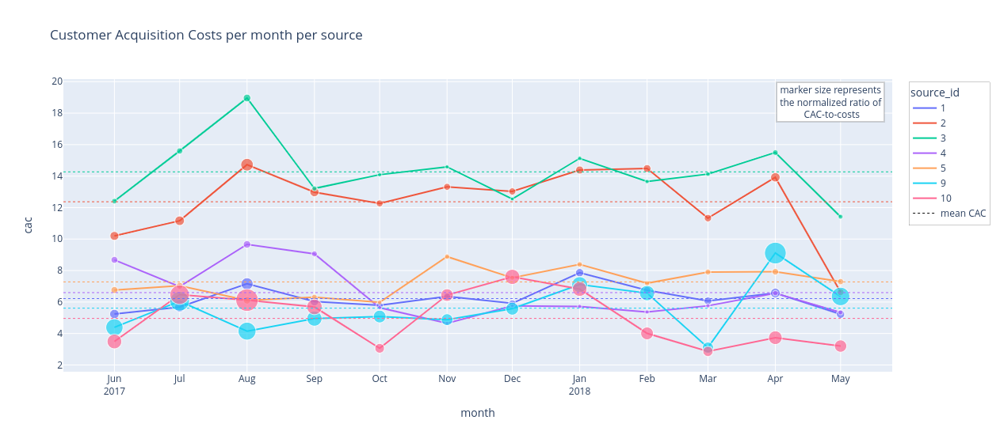

In [104]:
# plotting cac dynamics
fig = px.line(
    cac_per_month_source,
    x="month",
    y="cac",
    color='source_id',
    title='Customer Acquisition Costs per month per source',
    height=550
)

# dotted lines for mean cac per source
for i, trace in enumerate(fig['data']):
    fig.add_hline(
        y=mean_cac_per_source[int(trace['name'])],
        line_color=trace['line_color'],
        line_width=1,
        line_dash='dot',
    )

# legend entry for mean
fig.add_trace(
    go.Scatter(
        x=[None],
        y=[None],
        mode='lines',
        line=dict(
            width=1,
            color='black',
            dash='dot'
        ),
        legendgroup='mean',
        showlegend=True,
        name='mean CAC'
    )
)

## markers with size controled by cac-to-costs ratio
# add a color column to the CAC dataframe 
#    based on previously assignd colors (from initial figure)
source_colors = {
    int(trace['name']): trace['line_color'] \
    for trace in fig.data \
    if trace.line.dash == "solid"
}
def color_by_source(row):
    source = row['source_id']
    return source_colors[source]
cac_per_month_source['color'] =  \
        cac_per_month_source.apply(color_by_source, axis=1)

# create the traces
fig2 = px.scatter( 
    cac_per_month_source,
    x='month',
    y='cac',
    size='cac_to_costs',
    color='color',
) 
# add traces to original figure
for i, trace in enumerate(fig2.data):
    fig.add_trace(
        fig2.data[i]
    )
# remove unnescery legend entries
fig.update_traces(
    selector={'mode': 'markers'},
    showlegend=False
)
# legend describing marker size logic
fig.add_annotation(
    text='marker size represents<br> the normalized ratio of <br> CAC-to-costs',
    align='center',
    showarrow=False,
    xref='paper',
    yref='paper',
    x=0.99,
    y=0.99,
    bordercolor='black',
    borderwidth=0.2,
    bgcolor='white'
)

# update default legend
fig.update_layout(
    legend=dict(
        bordercolor='black',
        borderwidth=0.2,
        y=0.99
    )
)

# ticks
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y"
)

fig.show()


+ Sources 2 and 3 (top-cac-sources) have a similar CAC throughout the year, considerably higher than all other sources.
+ For these two sources, a clear trend is observed, in which CAC goes up during the first few months of the year, generally steadying thereafter around the mean CAC (~12 and ~14 for source 2 and 3 respectively), and subsequently decreasing rapidly during the last month of the year.
+ Comparing the dynamics of _top-cac-sources_ with the corresponding absolute marketing costs, we notice an inverse relation in which, as marketing costs go up, cac typically goes down and vice versa.  
+ Since CAC represents the ratio of marketing costs (_costs_), to the number of newly aqcuired customers (_new-customers_), when _costs_ goes up and _new-cutomers_ stayes the same, than CAC is expected to increase. On the other hand if _costs_ go up and _new-customers_ goes up more rapidly, than CAC will go down. The later case describes the trend for _top-cac-sources_, where for example, increases in marketing spending between August-September had seen parllel (and proportionally higher) increases in _new-customers_, to the point that CAC was considerably reduced (in the above plot, this trend is represented by a decrease in marker size in conjuction with a decrease in CAC). This most likely reflects the success of marketing efforts in bringing new customers, and suggests a kind of synegetic effect, in which increasing marketing spending caused a reduction in CAC (i.e. marketing expenses per new customer).\
This synergistic effect could be due to word-of-mouth circulation of the product (_marketing buzz_) causing marketing efforts to be more effective.
+ The rest of the sources typically show a similar CAC (within themselvs) ranging on average between ~5-7, with considerably more moderate flactuations compared with _top-cac-sources_.

### Return of Investment (ROI)
This metric reflect the ratio, per customer, of acquisation costs to revenue produced. Following this metric over time, for example within cohort analysis, allows us to determine the time-to-return-of-investment. 

#### Cohort ROI

In [105]:
# combine CAC data with LTV data based on first order month
cac_per_month_roi = cac_per_month[['month','cac']]
cac_per_month_roi.columns = [
    'first_order_month',
    'cac'
]
roi = ltv_cohorts.merge(
    cac_per_month_roi,
    on=['first_order_month'],
    how='left'
)

In [106]:
# compute ROI
roi['roi'] = roi['ltv'] / roi['cac']


In [107]:
# ROI per cohort per cohort cycle
roi_pivot = roi.pivot_table(
    index='first_order_month',
    columns='cycle',
    values='roi',
    aggfunc='mean'
)

# cumulative ROI
cumulative_roi = \
        roi_pivot.cumsum(axis=1).round(2) 

In [108]:
# prepare data for plotting with plotly
df = cumulative_roi.reset_index().melt(id_vars='first_order_month')
df = df.rename(columns={'first_order_month': 'cohort', 'value': 'roi'})
df['cohort'] = df.cohort.dt.strftime('%B, %Y')

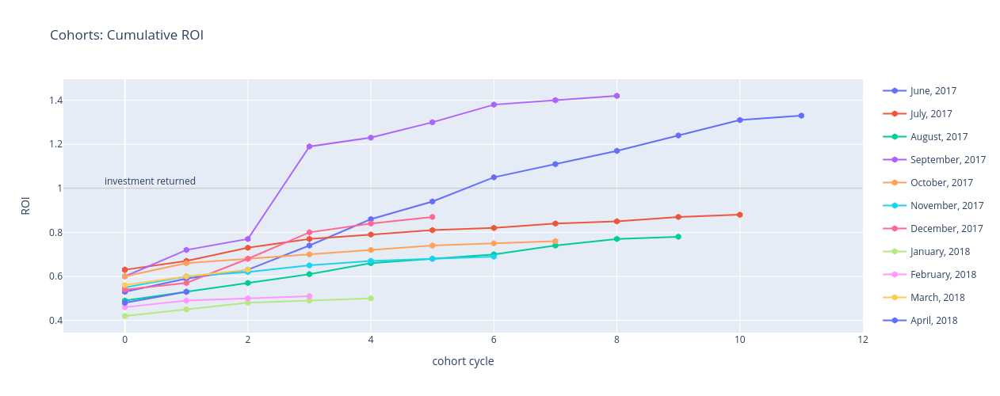

In [109]:
fig = go.Figure(
    layout_height=500,
    layout_title=dict(
        text='Cohorts: Cumulative ROI',
    ),
    layout_xaxis=dict(
        title='cohort cycle'
    ),
    layout_yaxis=dict(
        title='ROI'
    )
    
)
fig.add_trace(
    go.Scatter(
        x=np.arange(-1, 13),
        y=np.ones((14)),
        name='unit roi',
        mode='lines',
        line=dict(
            color='gray',
            width=0.5,
        ),
        showlegend=False
    )
)
fig.add_annotation(
    text='investment returned',
    xref='paper',
    yref='paper',
    x=0.05,
    y=0.6,
    showarrow=False
)
fig_lines = px.line(
    df,
    x="cycle",
    y="roi",
    color='cohort',
    height=550
)
for trace in fig_lines.data:
    fig.add_trace(
        trace
    )
    
fig.update_traces(
    mode='lines+markers',
    selector=lambda x: True if x['name'] != 'unit roi' else False
)
fig.update_traces(
    marker=dict(
        size=8,
        symbol='hexagon'
    ),
    selector=dict(mode='lines+markers')
)


fig.show()


+ June and September 2017 cohorts were notably more succesfull than other cohorts, reaching ROI of 1 after 6 and 3 cohort cycles respectively.
+ All other cohorts did not reach ROI of 1, thus not returning the investment, regaredless of cohort cycle.

#### ROI per source

In [110]:
ltv_per_source = orders \
        .groupby(['first_source'])[['uid','revenue']] \
        .agg({'uid':'nunique','revenue':'sum'}).reset_index()
ltv_per_source.columns = [
    'source_id',
    'users',
    'revenue'
]
ltv_per_source['ltv'] = \
        ltv_per_source['revenue'] / ltv_per_source['users']


In [111]:
roi_per_source = total_costs_per_source.merge(
    ltv_per_source,
    on=['source_id']
)
roi_per_source['cac'] = \
        roi_per_source['costs'] / roi_per_source['users']
roi_per_source['roi'] = \
        roi_per_source['ltv'] / roi_per_source['cac']
roi_per_source

,source_id,costs,users,revenue,ltv,cac,roi
0,1,20833.269531,3367,35155.570312,10.441215,6.187487,1.687473
1,2,42806.039062,3532,45413.949219,12.857857,12.119490,1.060924
2,3,141321.625000,10141,52791.011719,5.205701,13.935670,0.373552
3,4,61073.601562,10032,55557.531250,5.538031,6.087879,0.909682
4,5,51757.101562,7100,53235.230469,7.497920,7.289733,1.028559
5,9,5517.490234,1051,5547.950195,5.278735,5.249753,1.005521
6,10,5822.490234,1299,4354.740234,3.352379,4.482287,0.747917


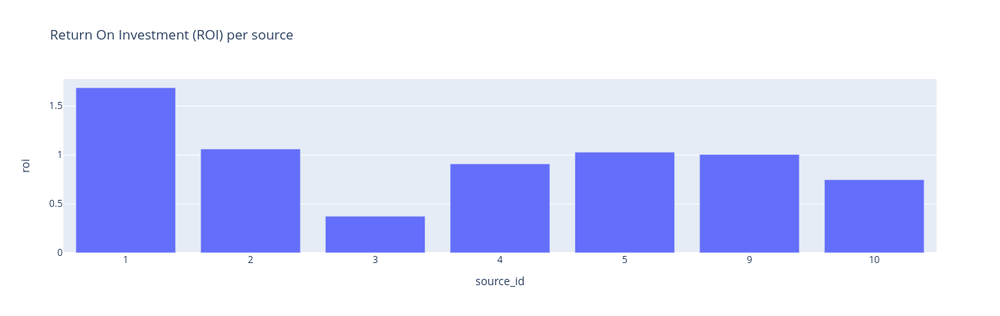

In [112]:
fig = px.bar(
    roi_per_source,
    title='Return On Investment (ROI) per source',
    x='source_id',
    y='roi',
    height=400
)
fig.update_xaxes(type='category')
fig.show()

+ Source 1 stands out in terms of return on investment with more than 150% return on investment.
+ All other sources show similar values, nearing the break even line in terms of ROI.
+ Source 3 has a notably lower value of ROI, less than 50%

# Project Conclusions

## Project description

Yandex.Aisha, is an online service, selling tickets to concerts, shows and movies. our task in this project was to analyze data from Afisha and help optimize marketing expenses for the product.\ 
the data contained records between june 2017 through may 2018, divided into three data-sets: 

-   user behaviour
-   sales
-   marketing expenses (aggregated by ad source)

## Pre-processing

a general overview of the data was performed and data types were optimized for lower memory usage.

## Analysis

the data was analyzed in three sections in accordance with the division of the main data-sets, using below two main approaches:

-   Analyzing overall distribution and dynamics of various features and metrics of the data.
-   Monthly cohort analysis was used, with the purpose of revealing user and sales patterns that may be related to marketing dynamics such as total spending and spending per source ad.

### User behaviour

+ Active Users (AU)

    -   Unique user activity (AU numbers), reflecting primarily the general interest in the product, was notably concentrated within the winter months, with a significant peak around the end of November and a downwards trend thereafter. These dynamics, can be related to both marketing spending, showing a closely parallel trend, as well as seasonal trends linked with holiday and special events timings, for example Black Friday week in conjunction with peak user activity, and summer holidays' alignment with low user activity months.

+ Sessions

    -   The number of sessions per day followed a similar trend as with AU numbers, and the number of sessions per user per day was mostly constant. This implied the overall number of sessions, was mainly a function of unique users numbers rather than recurrent sessions, which was in accordance with fairly low values for both weekly and monthly sticky factor (a measure of the rate of customers' repeating sessions).
    -   Typical session length was ~10 minutes.

+ User retention

    -   Monthly cohort analysis showed user retention to be lower than 10% right after the initial cohort month and retention rates genrelly decreased consistently with each subsequent cohort cycle (age). This trend was intensified as cohort initial month was more recent (i.e. retention rate decreased more rapidly for more recent cohorts). In particular, the first cohort (June 2017) presented considerably higher retention rates throughout most cohort cycles, compared with all other cohorts.



### Sales

+ Conversion

    -   Conversion typically took place after 1 day, with the majority of conversions happening after no more than 10 days.

+ Repeated purchases

    -   On average less than 10% of buyers placed repeated purchases after they've first used the product to purchase tickets.
    -   Among monthly cohorts, the June 2017 cohort stood out, reaching repeated purchases rate of above or close to 10% during Autumn-Winter months (3-8 cohort cycles).
    -   Apart from the June cohort, repeated purchase rate typically steadily declined with cohort age, reflecting the decline in user interest in the product as the time from first purchase increased.

+ Revenue per checkout

    -   The total revenue from each purchase (checkout) was mostly relatively constant, with a mean of 5\\$ per checkout.
    -   High total revenue (>10\\$) checkouts were not very common (~10%) but nonetheless comprised a major share of the total revenue.
    -   Revenue per checkout was mostly unrelated with cohort age.

+ LTV

    -   For most cohorts buyers will typically produce a cumulative LTV of ~6-8$ after 4 cohort cycles.
    -   Older cohorts normally showed higher cumulative LTV compared with more recent cohorts.
    -   The June and September 2017 cohorts had exceptionally high cumulative LTV after 5 and 3 cycles respectively.



### Marketing

+ Costs per source

    -   As mentioned earlier, marketing costs were concordant with active users dynamics, going up during winter months and then returning to previous levels in the spring.
    -   Source 3 had notably higher marketing costs than any other source.
    -   sources 4,5 and 10 had similar costs throughout the year, considerably lower than source 3 but higher than the remaining three sources 1, 2 and 9.
    -   sources 2 and 9 had particularly low (and steady) costs throughout the year while source one had slightly higher and slightly more varied monthly marketing costs.

+ Customer Acquisition Costs (CAC)

    -   The monthly average CAC showed an opposite trend from total monthly marketing costs in the sense that whenever marketing spending was reduced, or it's rate of increase between months was restricted, CAC had gone up . This is an interesting observation since it express the positive feedback effect of (continuously) increasing marketing spending on CAC. This positive feedback can be linked to the marketing buzz effect, in which continuous and increasingly intensive marketing efforts are able to raise awareness of the product, to the extent that acquisition of customers is largely transferred to the hands of customers themselves (through "mouth-to-word" spreading in social media outlets etc.), which would subsequently lower CAC.

+ Return On Investment (ROI)

    -   The June and September 2017 cohorts had on average returned the full marketing investment after 6 and 3 cohort cycles respectively.
    -   All other cohorts did not reach the full return on investment limit.
    -   Buyers who's source ad was 1 had on average an ROI of more than 150%, while all other sources had ROI of ~1 or lower.



## Final conclusions and recommendations

-   Successful cohorts in terms of ROI, were those who had high repeating purchases rates and/or particularly high revenue per checkout rates during some or most of the cohort cycles.
-   CAC was to a large extent inversely related with the total marketing costs, implying a synergistic effect of marketing spending on CAC, which we associated with a marketing buzz effect. This emphasizes the importance of concentrated marketing efforts in a relatively short period.
-   Source 1 was clearly a top source in terms of return on investment and should be focused upon also in the future. This source had low marketing costs throughout the year, which obviously contributed to it's high ROI rates. It should be noted however that sources 2 and 4, which had considerably higher costs, were the two most common sources for the two most successful monthly cohorts in terms of ROI. This suggest  these source ads are ones that target profitable customers.
-   Clearly source 3 had very poor results in terms of ROI, with exceptionally high marketing costs throughout the year and relatively low revenue, suggesting excessive spending on a particular source ad will not necessarily boost our ROI.

